<a href="https://colab.research.google.com/github/Krishnan-Raghavan/Packt/blob/main/StableDiffusionChapter4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install ipyplot

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 15.1 MB/s eta 0:00:00


/usr/local/lib/python3.10/dist-packages/ipyplot/_utils.py:95: FutureWarning: The input object of type 'Image' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Image', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  return np.asarray(seq, dtype=type(seq[0]))



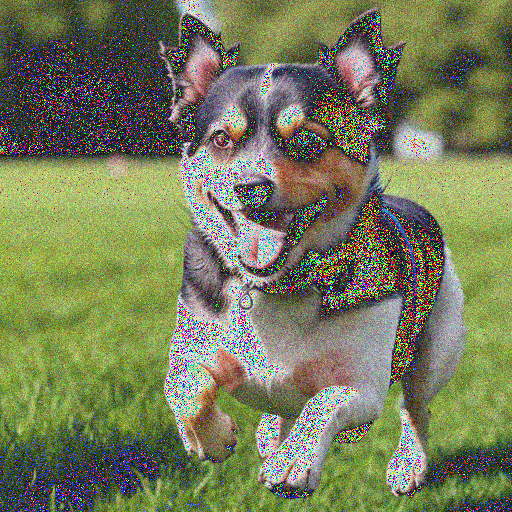
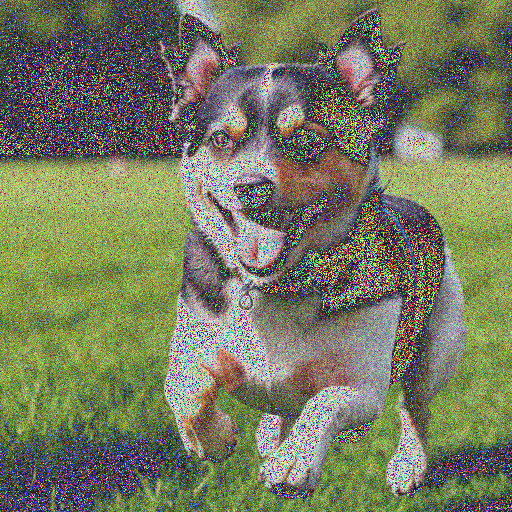
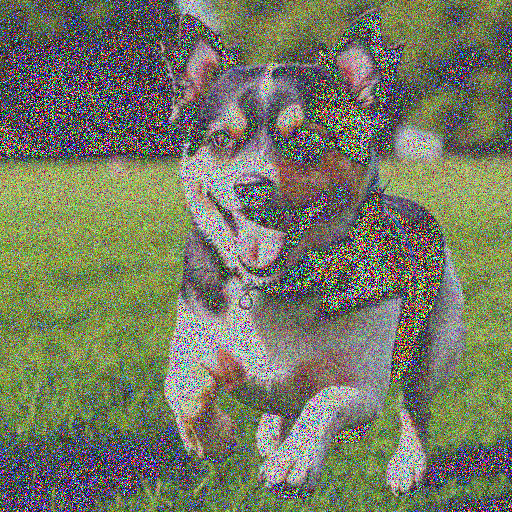
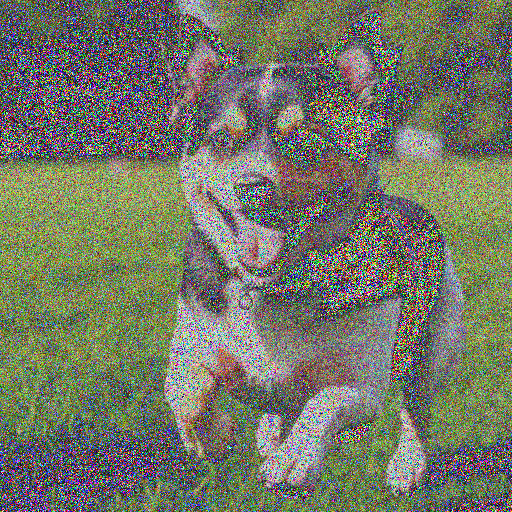
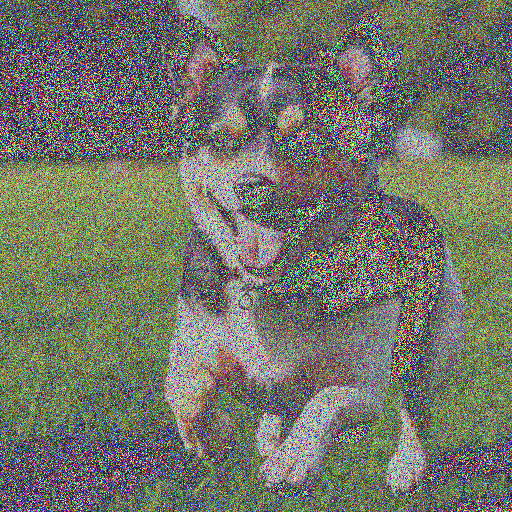
...
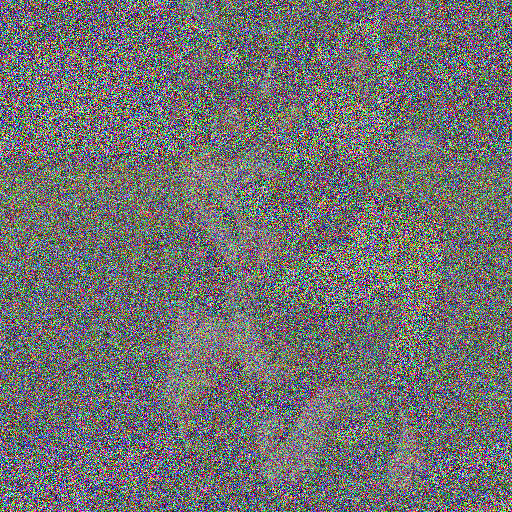
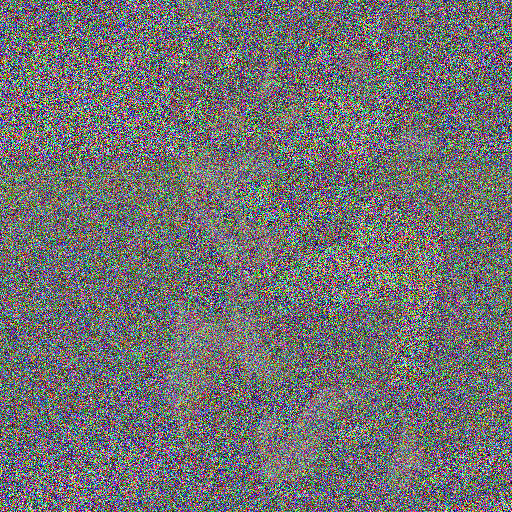
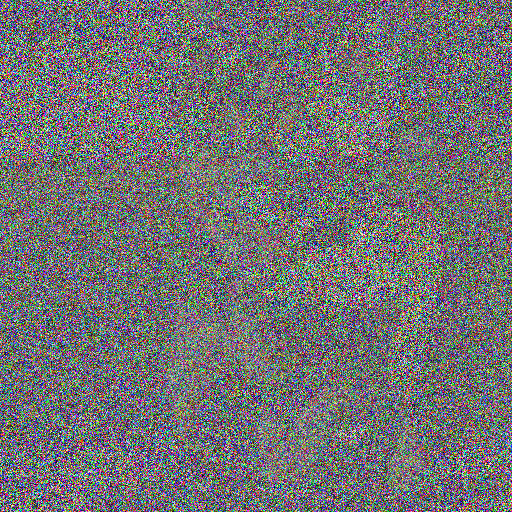
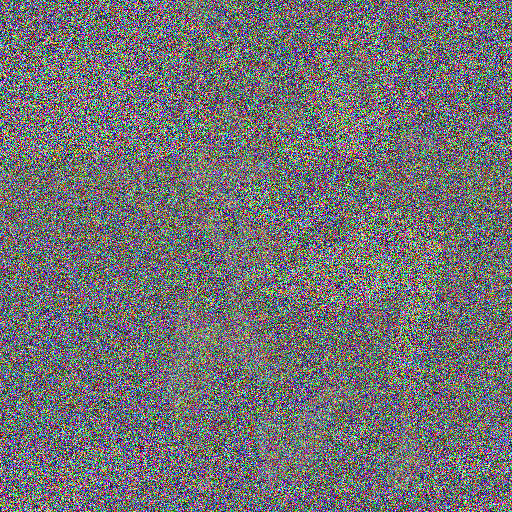
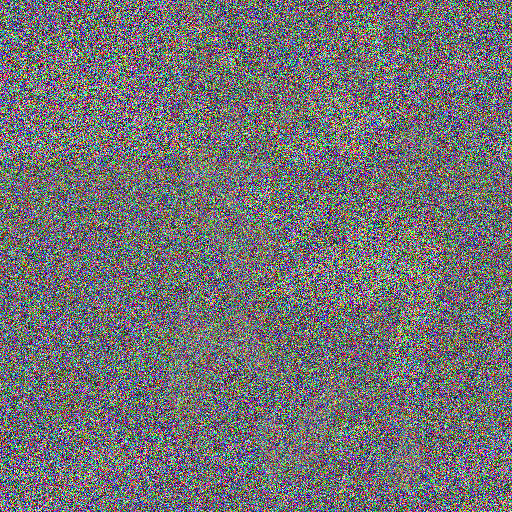

In [7]:
import numpy as np
import matplotlib.pyplot as plt
import ipyplot
from PIL import Image

# Load an image
img_path = r"/dog.png"
image = plt.imread(img_path)

# Parameters
num_iterations = 16
beta = 0.1              # noise_variance

images = []
steps = ["Step:"+str(i) for i in range(num_iterations)]

# Forward diffusion process
for i in range(num_iterations):
    mean = np.sqrt(1 - beta) * image
    image = np.random.normal(mean, beta, image.shape)

    # convert image to PIL image object
    pil_image = Image.fromarray((image * 255).astype('uint8'), 'RGB')

    # add to image list
    images.append(pil_image)

ipyplot.plot_images(images, labels=steps, img_width=120)

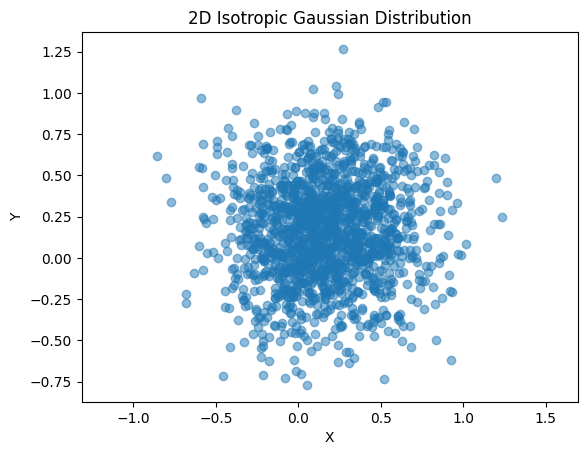

In [8]:
sample_img = image  # take the last image from the diffusion process

plt.scatter(sample_img[:, 0], sample_img[:, 1], alpha=0.5)
plt.title("2D Isotropic Gaussian Distribution")
plt.xlabel("X")
plt.ylabel("Y")
plt.axis("equal")
plt.show()

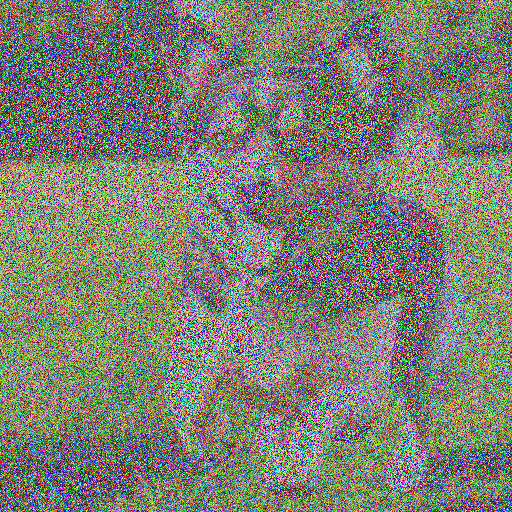

In [10]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from itertools import accumulate

def get_product_accumulate(numbers):
    product_list = list(accumulate(numbers, lambda x, y: x * y))
    return product_list

# Load an image
img_path = r"/dog.png"
image = plt.imread(img_path)
image = image * 2 - 1                   # [0,1] to [-1,1]

# Parameters
num_iterations = 16
beta = 0.05                             # noise_variance
betas = [beta]*num_iterations

alpha_list = [1 - beta for beta in betas]

alpha_bar_list = get_product_accumulate(alpha_list)

target_index = 5
x_target = (
    np.sqrt(alpha_bar_list[target_index]) * image
    + np.sqrt(1 - alpha_bar_list[target_index]) * np.random.normal(0,1,image.shape)
)

x_target = (x_target+1)/2

x_target = Image.fromarray((x_target * 255).astype('uint8'), 'RGB')
display(x_target)